# Solar Power Data Exploration
### This notebook aims to perform exploratory data analysis of the Solar Power data described below.
#### By Elliot Taylor

First we will import all the python libraries we need.

In [126]:
import pandas as pd
import matplotlib as mp
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import sklearn
import scipy.stats as stats
from sklearn import preprocessing
from datetime import datetime
from heatmap import heatmap, corrplot

Next we will load the two datasets from: https://data.open-power-system-data.org/weather_data/ and https://data.open-power-system-data.org/time_series/
These Datasets have been downloaded from the above links and modified to only include data for Great Britain for 2015-2016

In [5]:
df_timeseries = pd.read_csv("Data/time_series_60min_GB.csv")
df_weather = pd.read_csv("Data/weather_data.csv")

Below we can see that both data sets have 17544 entries, one for each hour from 2015-2016.

The timeseries dataset contains 5 columns which describe:
<pre>
- GB_GBN_load_actual_tso                      -> Total load in Great Britain in MW as published by own calculation based on National Grid  
- GB_GBN_load_forecast_entsoe_transparency    -> Day-ahead load forecast in Great Britain in MW as published on ENTSO-E Transparency Platform  
- GB_GBN_price_day_ahead                      -> Day-ahead spot price for Great Britain in GBP  
- GB_GBN_solar_capacity	                      -> Electrical capacity of solar in Great Britain in MW  
- GB_GBN_solar_generation_actual              -> Electrical generation of solar in Great Britain in MW  
<pre>
The weather dataset contains 3 columns which describe:
<pre>
- GB_temperature                              -> temperature weather variable for GB in degrees C
- GB_radiation_direct_horizontal              -> radiation_direct_horizontal weather variable for GB in W/m2
- GB_radiation_diffuse_horizontal             -> radiation_diffuse_horizontal weather variable for GB in W/m2
<pre>

In [6]:
df_timeseries.describe()

,GB_GBN_load_actual_tso,GB_GBN_load_forecast_entsoe_transparency,GB_GBN_price_day_ahead,GB_GBN_solar_capacity,GB_GBN_solar_generation_actual
count,17544.000000,17544.000000,17495.000000,17544.000000,17544.000000
mean,31787.154925,35811.365082,40.300069,5780.601117,1342.199384
std,7047.533918,7543.659437,23.714182,1414.058134,1635.610639
min,16520.000000,19814.000000,0.000000,2669.000000,0.000000
25%,26270.750000,29946.000000,32.200000,5026.000000,0.000000
50%,31679.000000,36280.500000,37.700000,5633.000000,630.000000
75%,36529.000000,41140.000000,44.460000,7276.000000,2109.250000
max,52427.000000,55890.000000,999.000000,7491.000000,7731.000000


In [7]:
df_weather.describe()

,GB_temperature,GB_radiation_direct_horizontal,GB_radiation_diffuse_horizontal
count,17544.000000,17544.000000,17544.000000
mean,9.675360,70.386633,68.143843
std,5.267197,141.203234,91.514279
min,-2.602000,0.000000,0.000000
25%,5.680750,0.000000,0.000000
50%,9.434500,0.255300,5.435050
75%,13.557750,59.251700,122.265100
max,26.949000,797.202100,385.869900


We will combine the two dataframes to make them easier to work with.

In [8]:
df = pd.merge(df_weather, df_timeseries, left_index=True, right_index=True, how='outer')
df.drop(['utc_timestamp_y'], axis=1, inplace=True) 

In [9]:
df.describe()

,GB_temperature,GB_radiation_direct_horizontal,GB_radiation_diffuse_horizontal,GB_GBN_load_actual_tso,GB_GBN_load_forecast_entsoe_transparency,GB_GBN_price_day_ahead,GB_GBN_solar_capacity,GB_GBN_solar_generation_actual
count,17544.000000,17544.000000,17544.000000,17544.000000,17544.000000,17495.000000,17544.000000,17544.000000
mean,9.675360,70.386633,68.143843,31787.154925,35811.365082,40.300069,5780.601117,1342.199384
std,5.267197,141.203234,91.514279,7047.533918,7543.659437,23.714182,1414.058134,1635.610639
min,-2.602000,0.000000,0.000000,16520.000000,19814.000000,0.000000,2669.000000,0.000000
25%,5.680750,0.000000,0.000000,26270.750000,29946.000000,32.200000,5026.000000,0.000000
50%,9.434500,0.255300,5.435050,31679.000000,36280.500000,37.700000,5633.000000,630.000000
75%,13.557750,59.251700,122.265100,36529.000000,41140.000000,44.460000,7276.000000,2109.250000
max,26.949000,797.202100,385.869900,52427.000000,55890.000000,999.000000,7491.000000,7731.000000


In [10]:
df.columns = ["Timestamp","Temp","Rad_Direct","Rad_Diffuse","Load_Actual","Load_Forecast","Price_Day_Ahead","Solar_Cap","Solar_Gen"]

In [11]:
df.dtypes

Timestamp           object
Temp               float64
Rad_Direct         float64
Rad_Diffuse        float64
Load_Actual          int64
Load_Forecast        int64
Price_Day_Ahead    float64
Solar_Cap            int64
Solar_Gen            int64
dtype: object

In [12]:
df['Timestamp'] = pd.to_datetime(df['Timestamp'])

In [13]:
df.dtypes

Timestamp          datetime64[ns, UTC]
Temp                           float64
Rad_Direct                     float64
Rad_Diffuse                    float64
Load_Actual                      int64
Load_Forecast                    int64
Price_Day_Ahead                float64
Solar_Cap                        int64
Solar_Gen                        int64
dtype: object

We can see there are 49 null values in Price_Day_Ahead therefore we will drop these entries as they represent a relatively low number of entries.

In [14]:
df.isnull().sum()

Timestamp           0
Temp                0
Rad_Direct          0
Rad_Diffuse         0
Load_Actual         0
Load_Forecast       0
Price_Day_Ahead    49
Solar_Cap           0
Solar_Gen           0
dtype: int64

In [15]:
df.dropna(inplace=True)

In [16]:
df.isnull().sum()

Timestamp          0
Temp               0
Rad_Direct         0
Rad_Diffuse        0
Load_Actual        0
Load_Forecast      0
Price_Day_Ahead    0
Solar_Cap          0
Solar_Gen          0
dtype: int64

Now lets visualise the data.

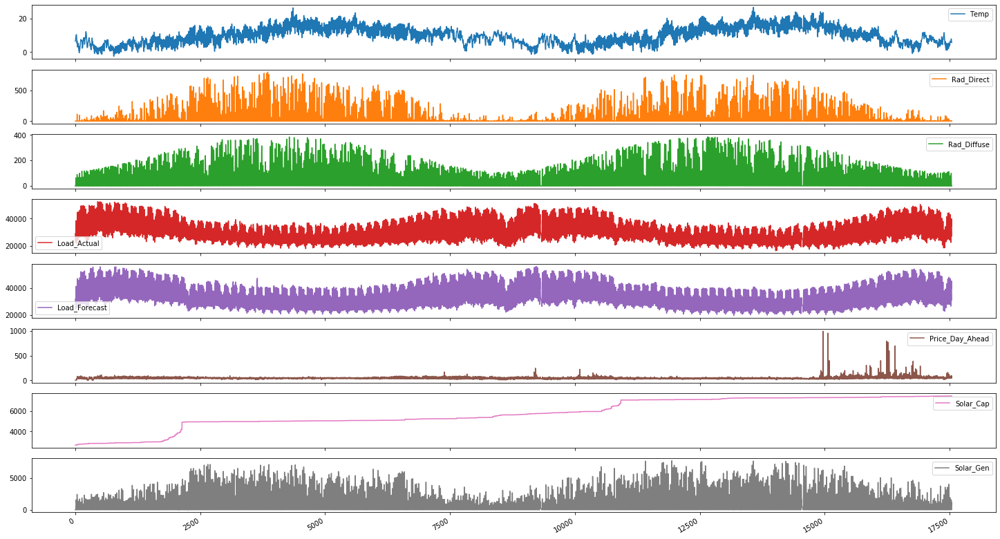

In [17]:
ax = df.drop(['Timestamp'], axis=1).plot(subplots=True,figsize=(25,15))
plt.savefig("Images/timelapse.png", bbox_inches='tight')

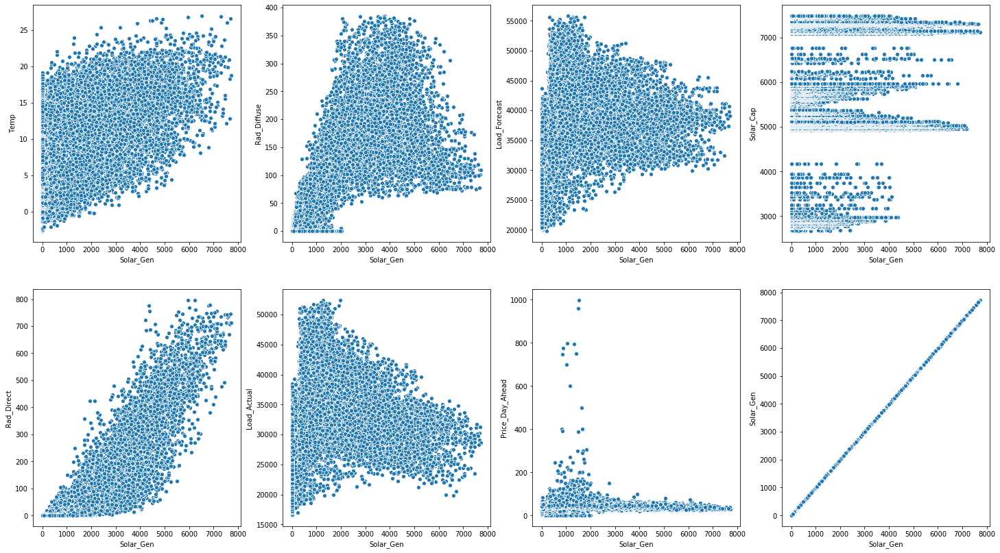

In [18]:
j = 0
i = 0

fig, ax = plt.subplots(ncols=4,nrows=2)

for column in df.columns[1:]:
    if i % 2 == 0 and i != 0:
        j = j + 1
        i = 0
    sns.scatterplot(x='Solar_Gen', y=column, data=df, ax=ax[i,j])
    fig.set_size_inches(25,14)
    i = i + 1

plt.savefig("Images/correlation.png", bbox_inches='tight')

In [19]:
df.corr().to_csv(r'Data/CorrelationMatrix.csv')

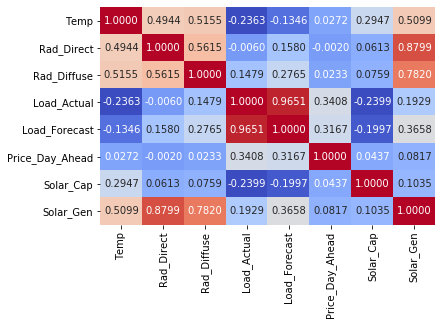

In [20]:
sns.heatmap(df.corr(method='pearson'), annot=True, fmt='.4f', cmap=plt.get_cmap('coolwarm'), cbar=False)
plt.savefig("Images/correlationMatrixPearson.png", bbox_inches='tight')

In [21]:
corrs = df[df.columns[:]].corr()['Solar_Gen'][:]
corrs.drop(labels='Solar_Gen', inplace = True)
corrs

Temp               0.509918
Rad_Direct         0.879922
Rad_Diffuse        0.781996
Load_Actual        0.192858
Load_Forecast      0.365811
Price_Day_Ahead    0.081723
Solar_Cap          0.103478
Name: Solar_Gen, dtype: float64

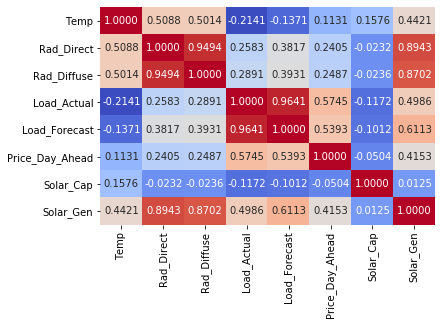

In [22]:
sns.heatmap(df.corr(method='spearman'), annot=True, fmt='.4f', cmap=plt.get_cmap('coolwarm'), cbar=False)
plt.savefig("Images/correlationMatrixSpearman.png", bbox_inches='tight')

In [23]:
df_features = df.drop(['Solar_Gen', "Timestamp"], axis=1) 
features = df_features.to_numpy()
target =  df['Solar_Gen'].to_numpy()

In [67]:
normalized_df=(df-df.min())/(df.max()-df.min())
normalized_df.to_csv("Data/PreparedData.csv")

## Feature Selection

In [25]:
from sklearn.ensemble import RandomForestRegressor

model = RandomForestRegressor(random_state=1, max_depth=10)

model.fit(features,target)

RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=10, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=100, n_jobs=None, oob_score=False,
                      random_state=1, verbose=0, warm_start=False)

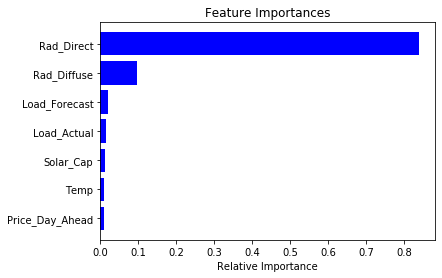

In [26]:
features = df_features.columns
importances = model.feature_importances_
indices = np.argsort(importances)[-9:]  # top 10 features
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='b', align='center')
plt.yticks(range(len(indices)), [features[i] for i in indices])
plt.xlabel('Relative Importance')
plt.savefig("Images/featureImportances.png", bbox_inches='tight')
plt.show()


Text(0.5, 1, 'Distribution of the normalized Load_Actual variable')

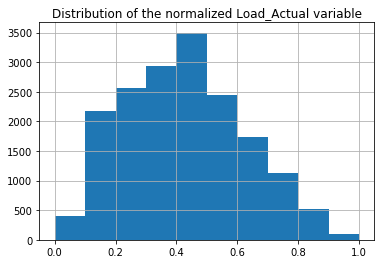

In [106]:
df["Load_Actual"].hist()
plt.title("Distribution of the normalized Load_Actual variable")
plt.savefig("Images/LoadActDist.png", bbox_inches='tight')

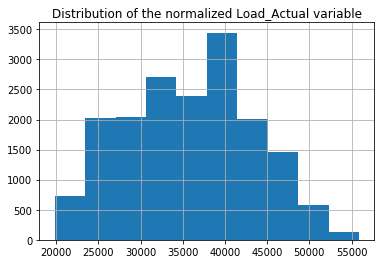

In [112]:
df["Load_Forecast"].hist()
plt.title("Distribution of the normalized Load_Actual variable")
plt.savefig("Images/LoadActDist.png", bbox_inches='tight')

In [117]:
from scipy.stats import ttest_ind

ttest_ind(df["Load_Actual"].values, df["Load_Forecast"].values)


Ttest_indResult(statistic=-51.57373991221023, pvalue=0.0)

In [118]:
ttest_ind(normalized_df["Load_Actual"].values, normalized_df["Load_Forecast"].values)

Ttest_indResult(statistic=-8.431654404880124, pvalue=3.536844161512354e-17)

In [127]:
fvalue, pvalue = stats.f_oneway(df["Load_Actual"], df["Load_Forecast"])
print(fvalue, pvalue)

2659.850648532302 0.0


In [129]:
fvalue, pvalue = stats.f_oneway(normalized_df["Load_Actual"],  normalized_df["Load_Forecast"])
print(fvalue, pvalue)

71.09279600333436 3.536844161498801e-17


In [132]:
import statsmodels.api as sm
from statsmodels.formula.api import ols

model = ols('Solar_Gen ~ C(Load_Actual) + C(Load_Forecast) + C(Load_Actual):C(Load_Forecast)', data=df).fit()
anova_table = sm.stats.anova_lm(model, typ=2)
anova_table

MemoryError: Unable to allocate 1.06 GiB for an array with shape (11904, 11904) and data type float64